<a href="https://colab.research.google.com/github/Hamza-benAmmar/tp4-Ml/blob/main/tp4_ML.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Imports**

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn import cluster
import numpy as np
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering
from scipy.spatial.distance import pdist, squareform


**EDA**

In [ ]:
fromage=pd.read_table(r"/content/fromage1.txt",sep="\t",header=0,index_col=0)
fromage.head()

,calories,sodium,calcium,lipides,retinol,folates,proteines,cholesterol,magnesium
Fromages,,,,,,,,,
CarredelEst,314,353.5,72.6,26.3,51.6,30.3,21.0,70,20
Babybel,314,238.0,209.8,25.1,63.7,6.4,22.6,70,27
Beaufort,401,112.0,259.4,33.3,54.9,1.2,26.6,120,41
Bleu,342,336.0,211.1,28.9,37.1,27.5,20.2,90,27
Camembert,264,314.0,215.9,19.5,103.0,36.4,23.4,60,20


In [ ]:
fromage.describe()

,calories,sodium,calcium,lipides,retinol,folates,proteines,cholesterol,magnesium
count,29.000000,29.000000,29.000000,29.000000,29.000000,29.000000,29.000000,29.000000,29.000000
mean,300.034483,210.086207,185.734483,24.158621,67.562069,13.010345,20.168966,74.586207,26.965517
std,91.914356,108.678923,72.528882,8.129642,24.163098,11.723339,6.959788,28.245755,11.318388
min,70.000000,22.000000,72.600000,3.400000,37.100000,1.200000,4.100000,10.000000,10.000000
25%,292.000000,140.000000,132.900000,23.400000,51.600000,4.900000,17.800000,70.000000,20.000000
50%,321.000000,223.000000,202.300000,26.300000,62.300000,6.400000,21.000000,80.000000,26.000000
75%,355.000000,276.000000,220.500000,29.100000,76.400000,21.100000,23.400000,90.000000,30.000000
max,406.000000,432.000000,334.600000,33.300000,150.500000,36.400000,35.700000,120.000000,51.000000


array([[<Axes: xlabel='calories', ylabel='calories'>,
        <Axes: xlabel='sodium', ylabel='calories'>,
        <Axes: xlabel='calcium', ylabel='calories'>,
        <Axes: xlabel='lipides', ylabel='calories'>,
        <Axes: xlabel='retinol', ylabel='calories'>,
        <Axes: xlabel='folates', ylabel='calories'>,
        <Axes: xlabel='proteines', ylabel='calories'>,
        <Axes: xlabel='cholesterol', ylabel='calories'>,
        <Axes: xlabel='magnesium', ylabel='calories'>],
       [<Axes: xlabel='calories', ylabel='sodium'>,
        <Axes: xlabel='sodium', ylabel='sodium'>,
        <Axes: xlabel='calcium', ylabel='sodium'>,
        <Axes: xlabel='lipides', ylabel='sodium'>,
        <Axes: xlabel='retinol', ylabel='sodium'>,
        <Axes: xlabel='folates', ylabel='sodium'>,
        <Axes: xlabel='proteines', ylabel='sodium'>,
        <Axes: xlabel='cholesterol', ylabel='sodium'>,
        <Axes: xlabel='magnesium', ylabel='sodium'>],
       [<Axes: xlabel='calories', ylabel='calc

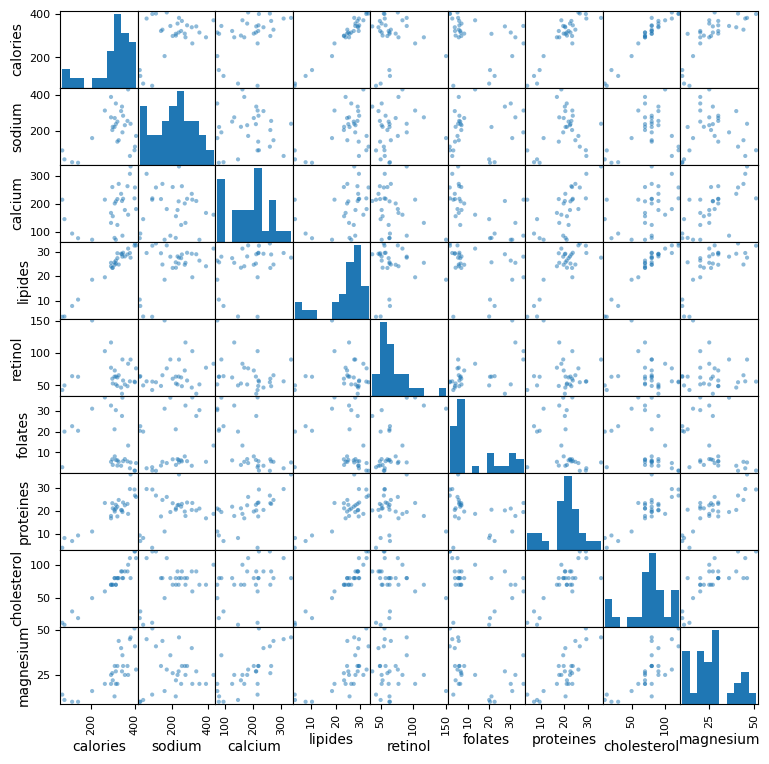

In [ ]:
pd.plotting.scatter_matrix(fromage, figsize=(9, 9))

based on the diagonal allure , les coubres qui ont la meme allure sont correles

From the scatter matrix , it can give us an idea about the correlations and the relationships between our features :



-Calories : there is a strong positive linear correlation between this feature and the lipides features while it has a somewhat strong correlation between the proteines and cholesterol (it shows a slightly curved pattern for these two) . As the scatter matrix shows , it has a somewhat low correlation between the calories features and the others features.


-Sodium : the scatter matrix doesn't show any strong corrleations between this feature and the others


-Calcium: the scatter matrix doesn't show any strong correlations between this feature and the others other than a somewhat strong between the calcium and the magnesium but it is not enough to say that it is linear


-Lipides : There is a strong corrleation with Cholesterol, a somewhat strong correlation with proteines and it shows a curved pattern with magnesium while it shows a low correlation with the rest of features.


-Retinol : the scatter matrix doesn't show any strong corrleations between this feature and the others


-Folates : the scatter matrix doesn't show any strong corrleations between this feature and the others

-Proteines : The scatter matrix shows a somewhat strong correlation between this feature and Cholestrol and Magnesium

Cholesterol: it shows soemthing between a somewhat strong correlation between this features and magnesium and a curved pattern

# **Partie 2 : Méthode des centres mobiles**

In [ ]:
kmeans = cluster.KMeans(n_clusters = 3,random_state=0)
kmeans.fit(fromage)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=3, random_state=0)

In [ ]:
fromage.head()

,calories,sodium,calcium,lipides,retinol,folates,proteines,cholesterol,magnesium
Fromages,,,,,,,,,
CarredelEst,314,353.5,72.6,26.3,51.6,30.3,21.0,70,20
Babybel,314,238.0,209.8,25.1,63.7,6.4,22.6,70,27
Beaufort,401,112.0,259.4,33.3,54.9,1.2,26.6,120,41
Bleu,342,336.0,211.1,28.9,37.1,27.5,20.2,90,27
Camembert,264,314.0,215.9,19.5,103.0,36.4,23.4,60,20


In [ ]:
kmeans.predict(fromage)

array([0, 3, 1, 3, 3, 3, 0, 0, 1, 1, 0, 1, 1, 0, 3, 2, 2, 3, 3, 1, 2, 0,
       3, 3, 3, 1, 0, 1, 2], dtype=int32)

In [ ]:
## Get the indices that sort the labels in an ascending order
idx=np.argsort(kmeans.labels_)
idx

array([ 0, 26, 21,  6,  7, 10, 13,  2, 25,  8,  9, 11, 12, 27, 19, 20, 28,
       15, 16, 17, 18,  5,  4, 22, 23, 24,  3,  1, 14])

In [ ]:
#sorted clusters
kmeans.labels_[idx]

array([0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3], dtype=int32)

In [ ]:
print(pd.DataFrame(fromage.index[idx],kmeans.labels_[idx]))

             Fromages
0         CarredelEst
0                Tome
0         PontlEveque
0           Chabichou
0            Chaource
0         Coulomniers
0  Fr.chevrepatemolle
1            Beaufort
1         SaintPaulin
1             Cheddar
1               Comte
1                Edam
1            Emmental
1            Vacherin
1            Parmesan
2       Petitsuisse40
2  Yaourtlaitent.nat.
2      Fr.frais20nat.
2      Fr.frais40nat.
3           Maroilles
3             Morbier
3              Cantal
3           Camembert
3            Pyrenees
3           Reblochon
3          Rocquefort
3                Bleu
3             Babybel
3         Fr.fondu.45


In [ ]:
#these are the attributes of each centroids of each cluster
centroids_attributes=pd.DataFrame(kmeans.cluster_centers_,columns=fromage.columns)
centroids_attributes.index=["cluster 0","cluster 1","cluster 2","cluster 3"]
centroids_attributes

,calories,sodium,calcium,lipides,retinol,folates,proteines,cholesterol,magnesium
cluster 0,297.857143,239.785714,103.842857,24.914286,83.928571,23.057143,18.971429,71.428571,21.714286
cluster 1,363.875000,146.125000,257.025000,29.050000,63.600000,3.862500,26.562500,96.250000,38.875000
cluster 2,101.750000,44.750000,133.750000,6.275000,55.150000,16.475000,7.200000,18.250000,11.250000
cluster 3,329.800000,306.600000,206.820000,26.870000,64.240000,11.910000,21.080000,82.000000,27.400000


In [ ]:
#display the distance of each instance to each
distance_to_centroids=kmeans.transform(fromage)
distances_to_centroids=pd.DataFrame(distance_to_centroids,columns=['distance to centroid 0','distance to centroid 1','distance to centroid 2','distance to centroid 3'])
distances_to_centroids['cluster']=kmeans.labels_
distances_to_centroids.index=fromage.index
distances_to_centroids

,distance to centroid 0,distance to centroid 1,distance to centroid 2,distance to centroid 3,cluster
Fromages,,,,,
CarredelEst,123.597157,285.361631,384.273010,145.469280,0
Babybel,110.546519,118.433791,303.103120,71.726811,3
Beaufort,235.256653,56.726033,349.913234,218.187927,1
Bleu,159.099847,200.304020,393.768988,45.609225,3
Camembert,141.191709,210.311383,332.434717,84.660519,3
Cantal,180.759825,111.731510,371.970767,86.999318,3
Chabichou,72.040455,182.805998,298.653003,170.261192,0
Chaource,57.862806,204.988232,311.489906,105.530372,0
Cheddar,156.415710,92.262237,348.486852,159.881517,1


The results in distances_to_centroids are accurate as each data point belongs to the cluster where its distance to the centroid is the smallest

**Visualizations of the centroids in 3D**

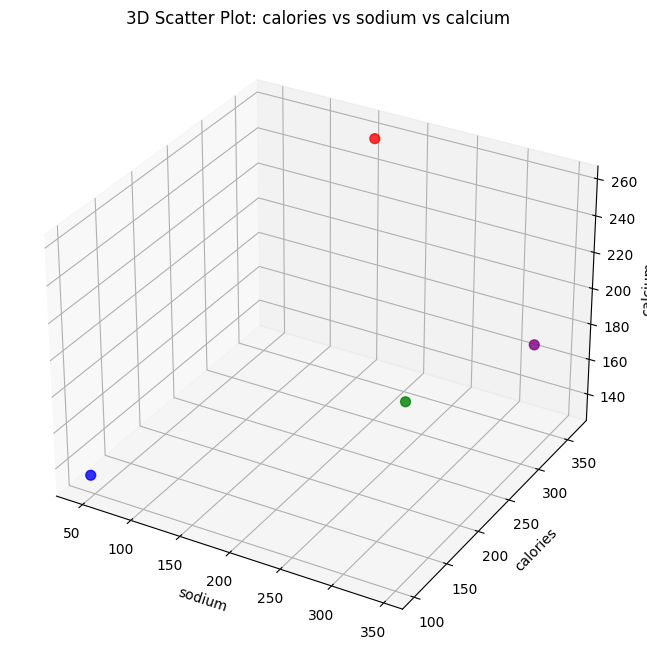

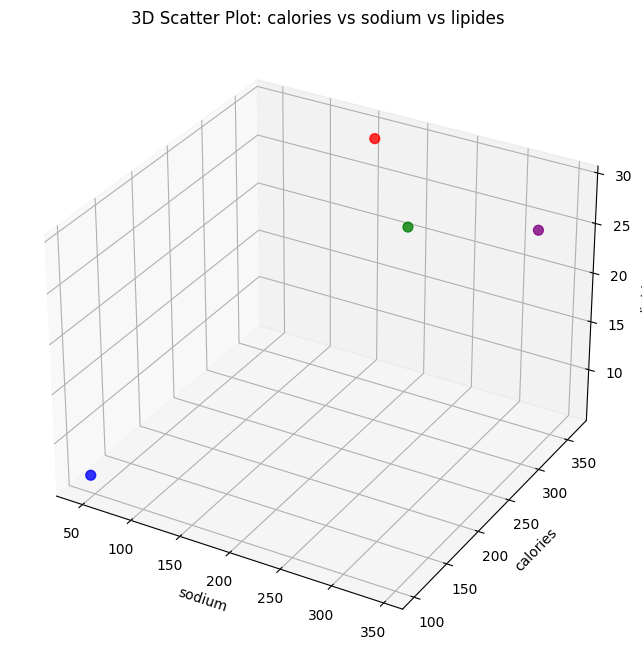

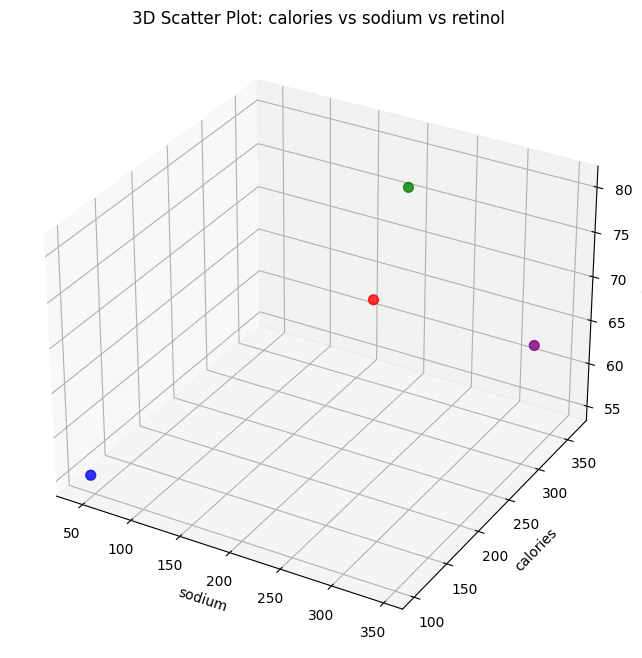

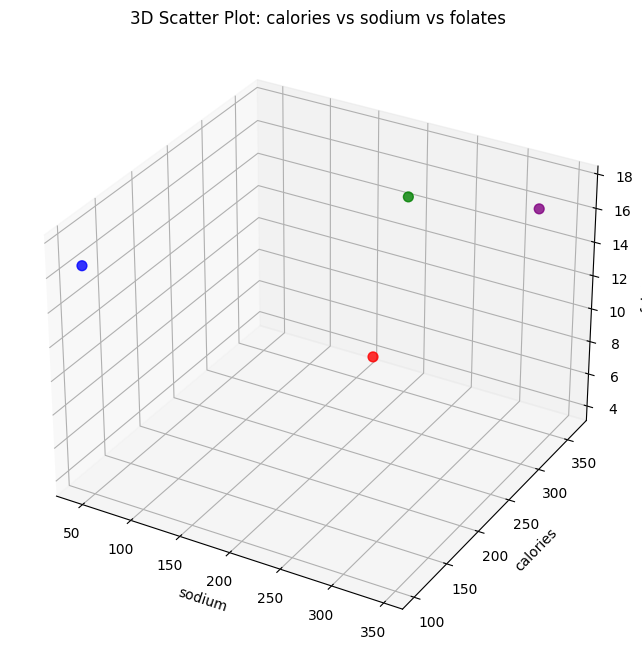

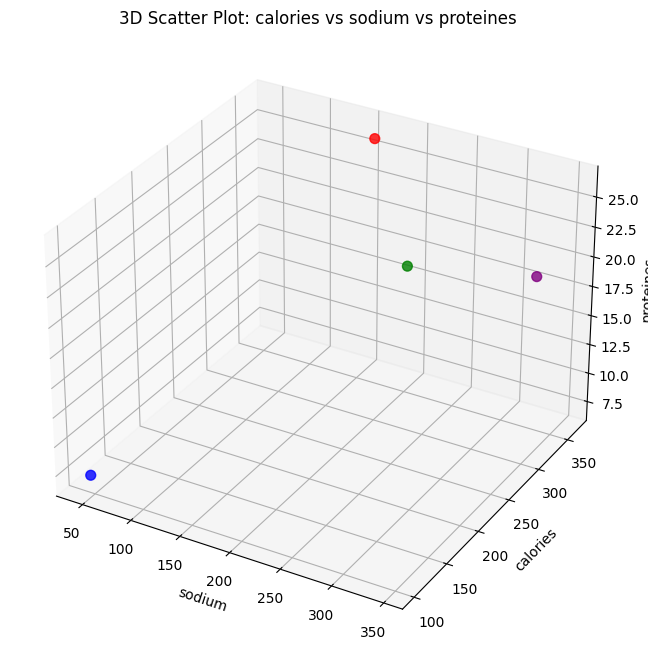

...

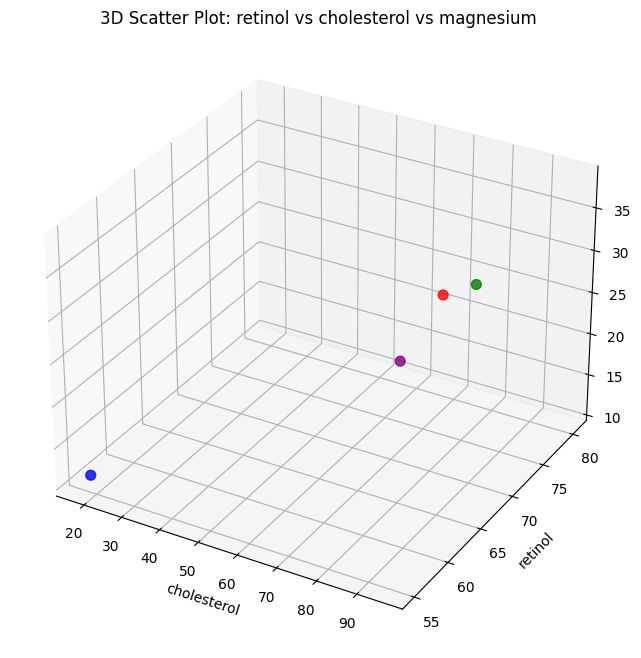

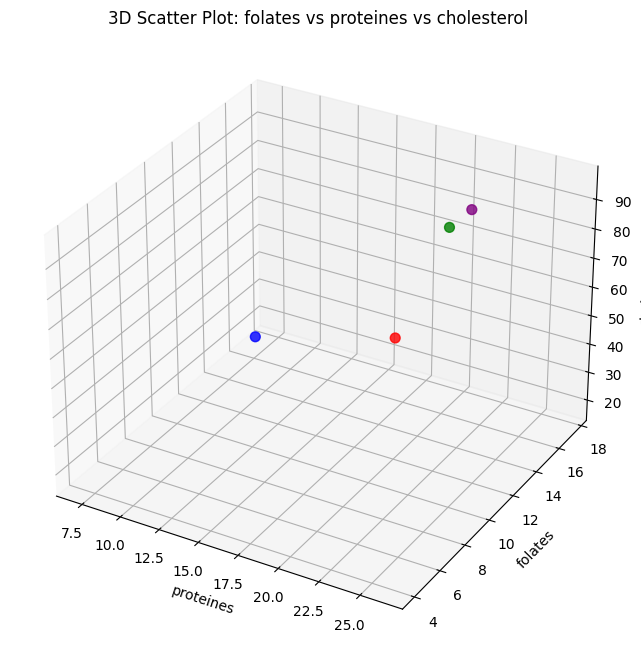

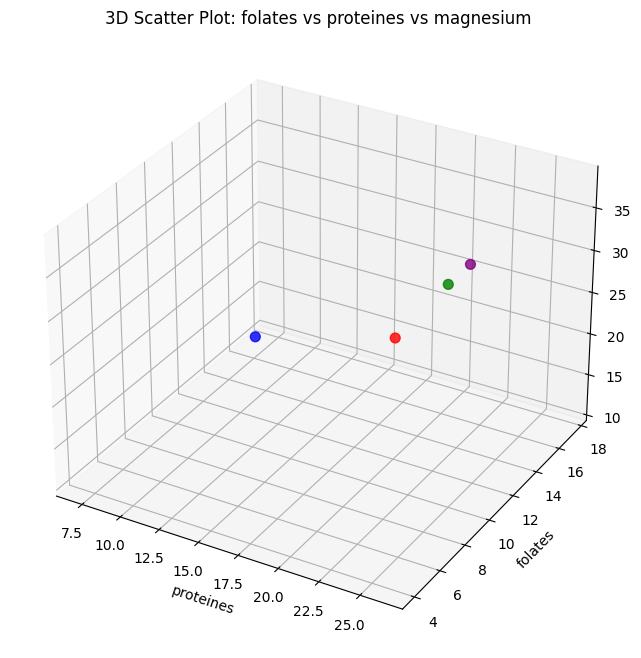

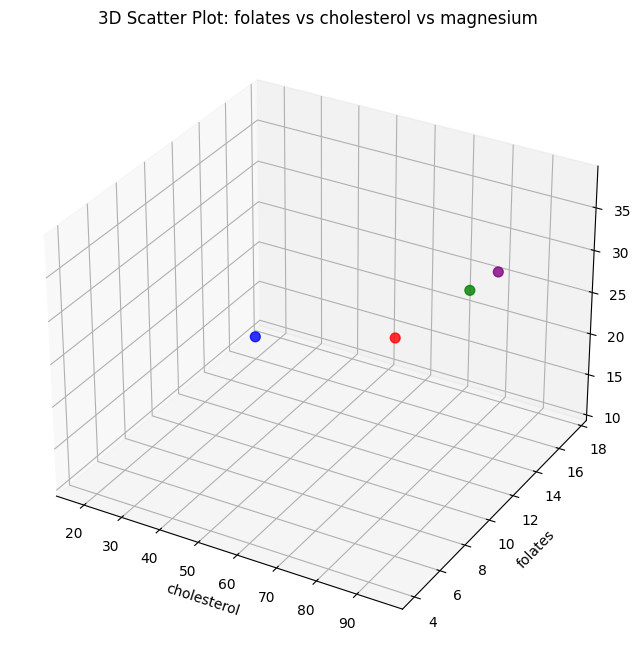

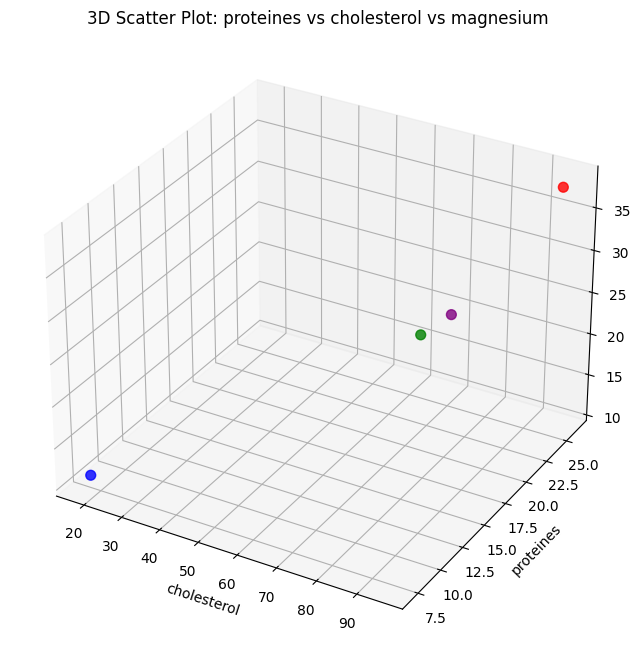

In [ ]:
colors = {0: 'red', 1: 'blue', 2: 'green', 3: 'purple'}  # Adjust to your 4 cluster colors

# Create 3D scatter plots for each triplet of features
feature_names = fromage.columns

for i in range(len(feature_names)):
    for j in range(i + 1, len(feature_names)):
        for k in range(j + 1, len(feature_names)):
            fig = plt.figure(figsize=(8, 8))
            ax = fig.add_subplot(111, projection='3d')

            ax.scatter(
                centroids_attributes.iloc[:, j],
                centroids_attributes.iloc[:, i],
                centroids_attributes.iloc[:, k],
                c=[colors[i] for i,cluster in enumerate(centroids_attributes.index)],
                s=50,  # Marker size
                alpha=0.8,
            )

            ax.set_xlabel(feature_names[j])
            ax.set_ylabel(feature_names[i])
            ax.set_zlabel(feature_names[k])
            ax.set_title(f'3D Scatter Plot: {feature_names[i]} vs {feature_names[j]} vs {feature_names[k]}')

            plt.show()

**Visualizations of the data points in 2D**

array([[<Axes: xlabel='calories', ylabel='calories'>,
        <Axes: xlabel='sodium', ylabel='calories'>,
        <Axes: xlabel='calcium', ylabel='calories'>,
        <Axes: xlabel='lipides', ylabel='calories'>,
        <Axes: xlabel='retinol', ylabel='calories'>,
        <Axes: xlabel='folates', ylabel='calories'>,
        <Axes: xlabel='proteines', ylabel='calories'>,
        <Axes: xlabel='cholesterol', ylabel='calories'>,
        <Axes: xlabel='magnesium', ylabel='calories'>],
       [<Axes: xlabel='calories', ylabel='sodium'>,
        <Axes: xlabel='sodium', ylabel='sodium'>,
        <Axes: xlabel='calcium', ylabel='sodium'>,
        <Axes: xlabel='lipides', ylabel='sodium'>,
        <Axes: xlabel='retinol', ylabel='sodium'>,
        <Axes: xlabel='folates', ylabel='sodium'>,
        <Axes: xlabel='proteines', ylabel='sodium'>,
        <Axes: xlabel='cholesterol', ylabel='sodium'>,
        <Axes: xlabel='magnesium', ylabel='sodium'>],
       [<Axes: xlabel='calories', ylabel='calc

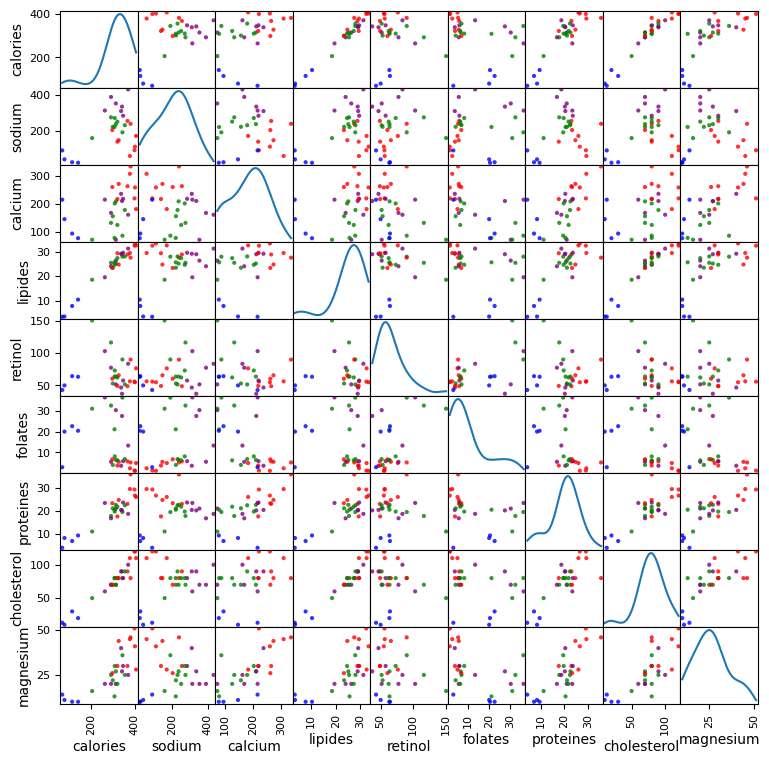

In [ ]:
pd.plotting.scatter_matrix(fromage, figsize=(9, 9), alpha=0.8, diagonal='kde', c=[colors[label] for label in kmeans.labels_])

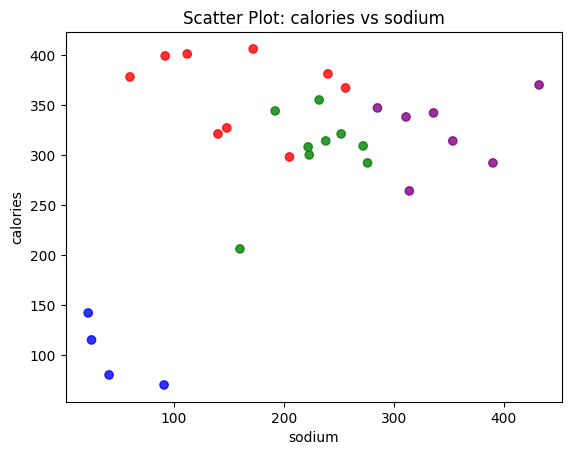

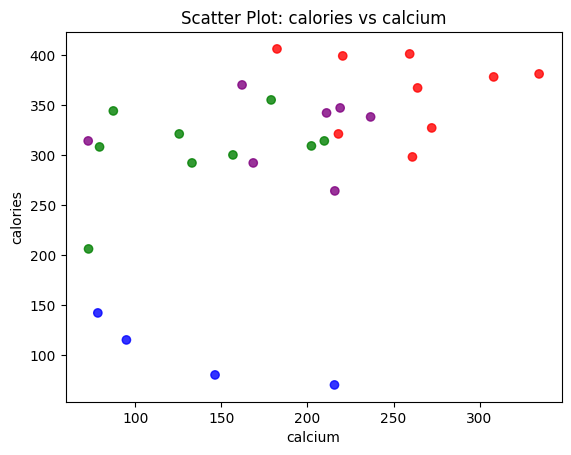

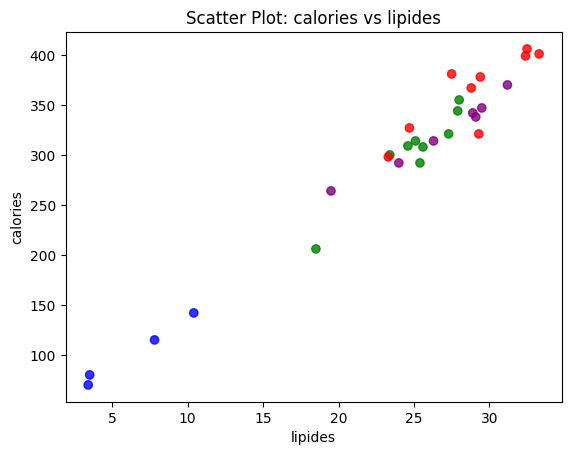

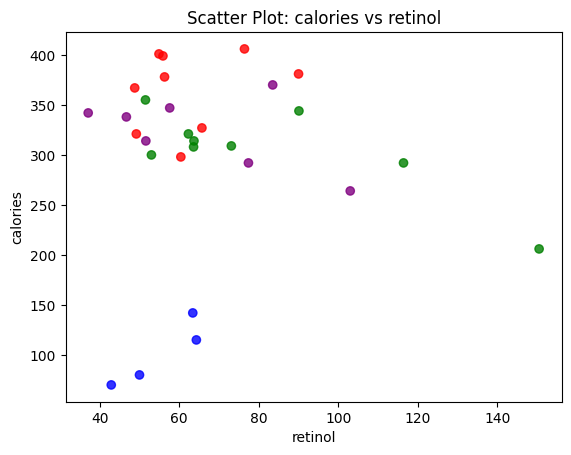

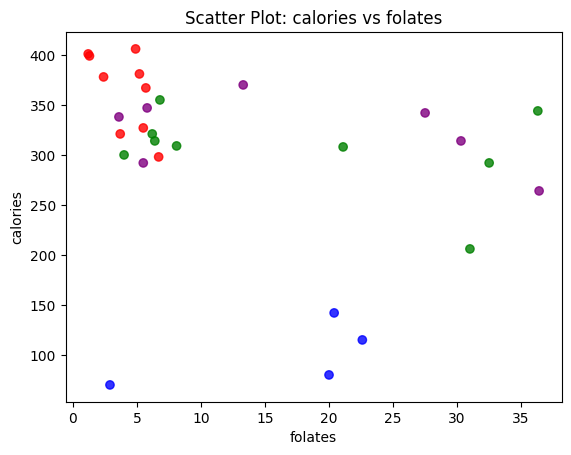

...

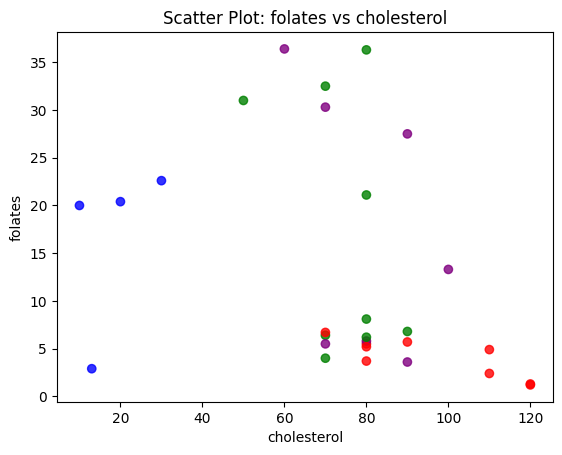

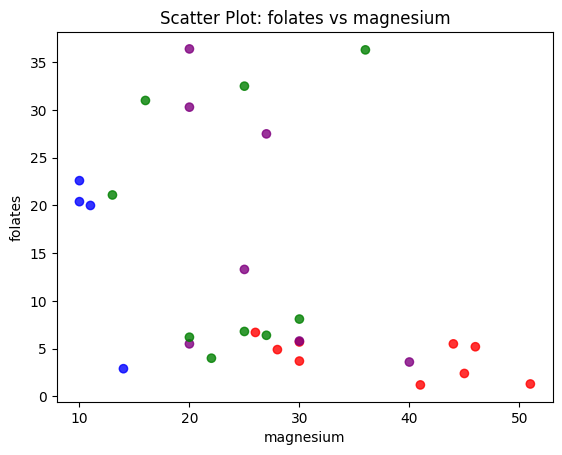

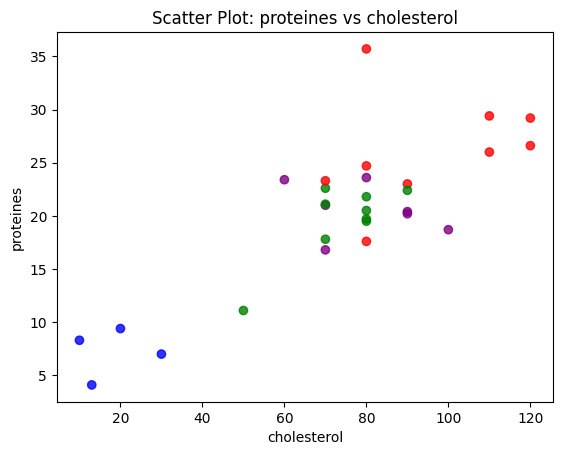

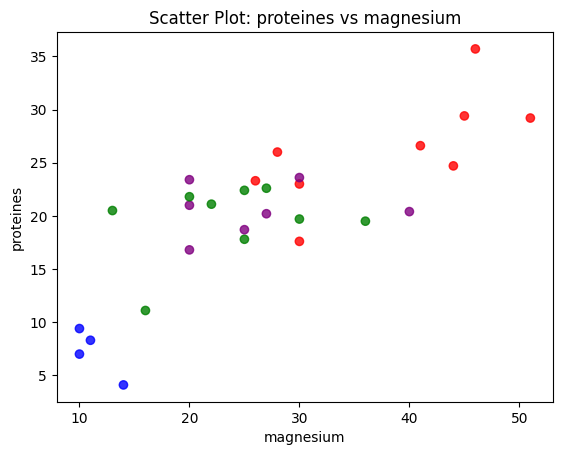

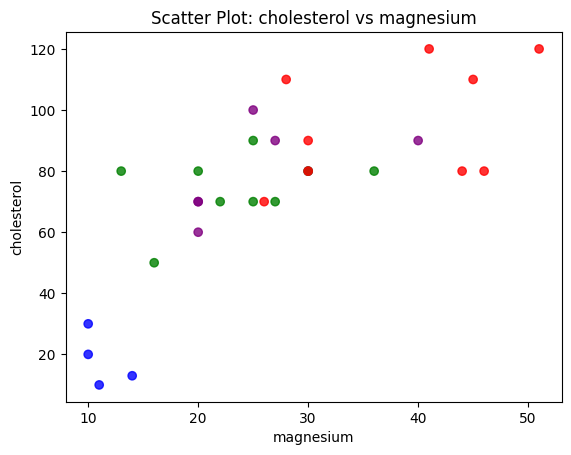

In [ ]:
colors = {0: 'red', 1: 'blue', 2: 'green', 3: 'purple'}  # Adjust to your 4 cluster colors

# Create scatter plots for each pair of features
feature_names = fromage.columns

for i in range(len(feature_names)):
    for j in range(i + 1, len(feature_names)):
        plt.scatter(
            x=fromage.iloc[:, j],
            y=fromage.iloc[:, i],
            c=[colors[label] for label in kmeans.labels_],
            alpha=0.8,
        )
        ax.scatter(
                kmeans.cluster_centers_[:, j],
                kmeans.cluster_centers_[:, i],
                kmeans.cluster_centers_[:, k],
                c=[colors[i] for i,cluster in enumerate(centroids_attributes.index)],  # You can choose a different color for centroids
                marker='X',  # You can choose a different marker style
                s=200,  # Marker size
                label='Cluster Centroids',
            )
        plt.xlabel(feature_names[j])
        plt.ylabel(feature_names[i])
        plt.title(f'Scatter Plot: {feature_names[i]} vs {feature_names[j]}')
        plt.show()

**Visualizations of the centroids in 3D**

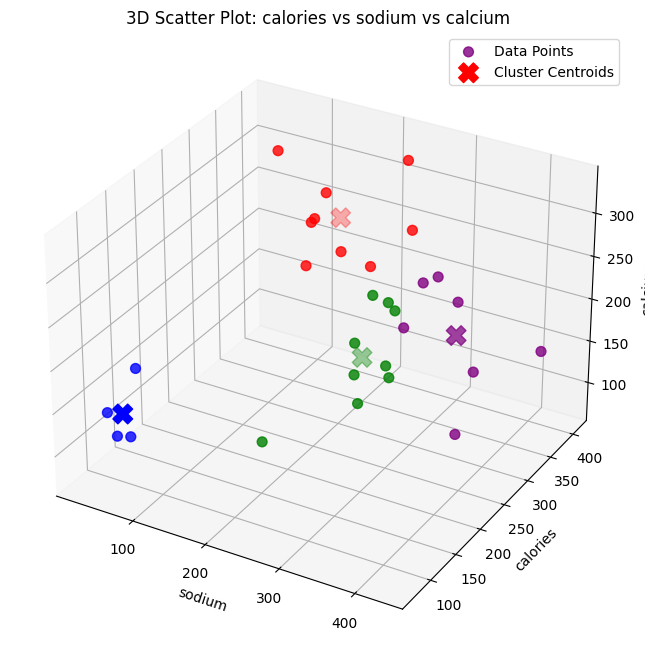

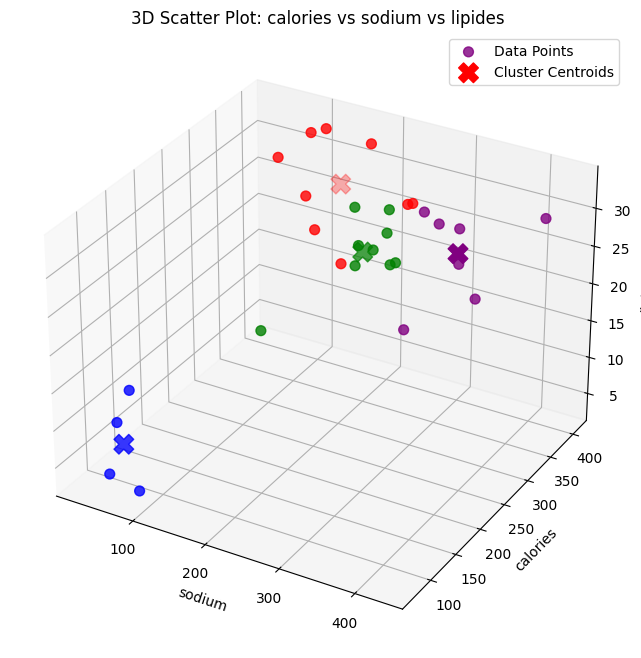

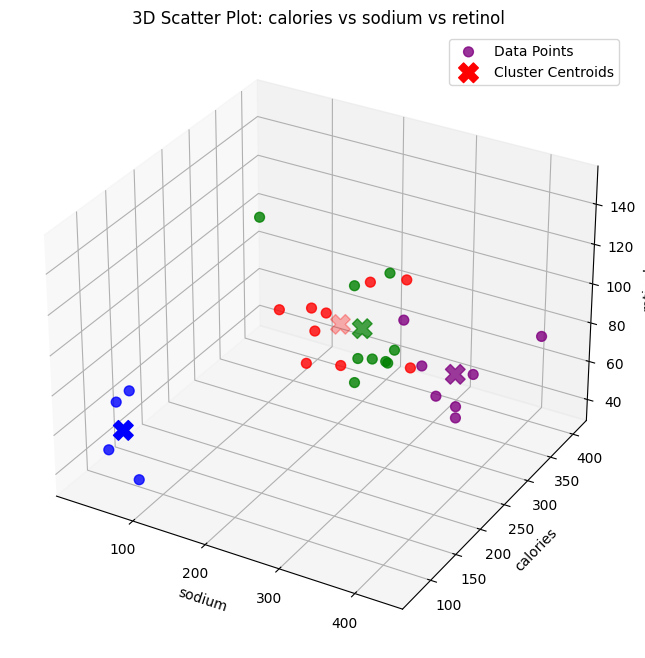

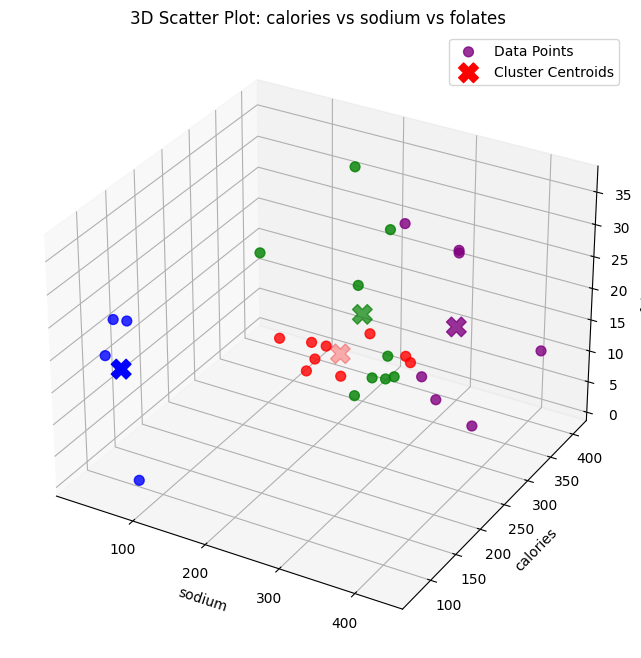

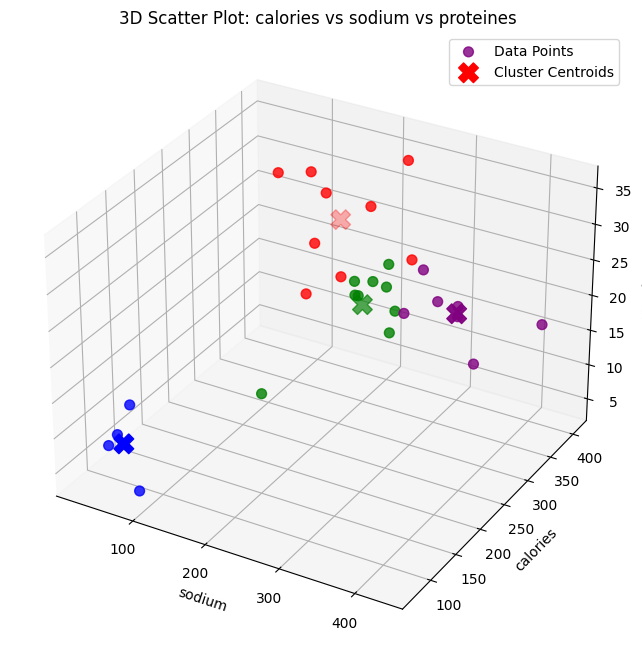

...

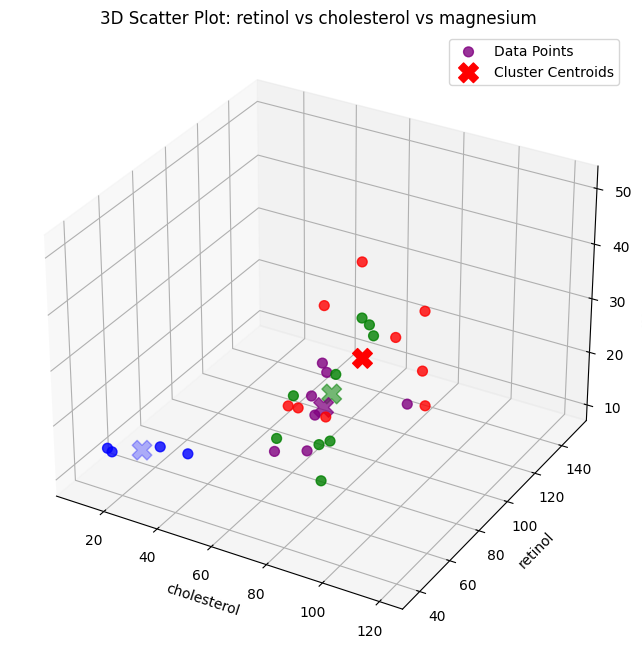

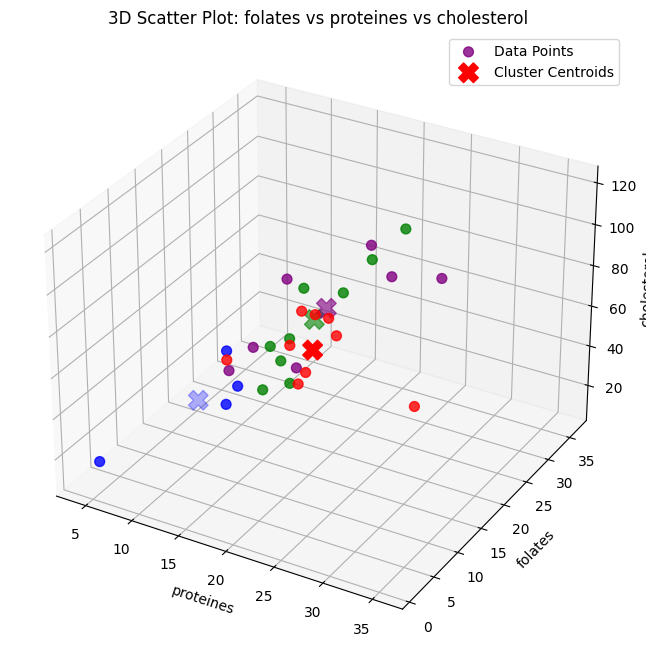

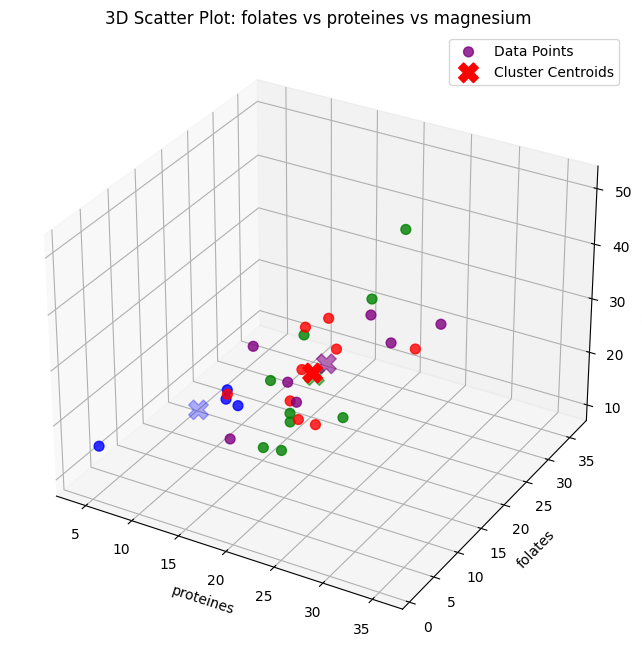

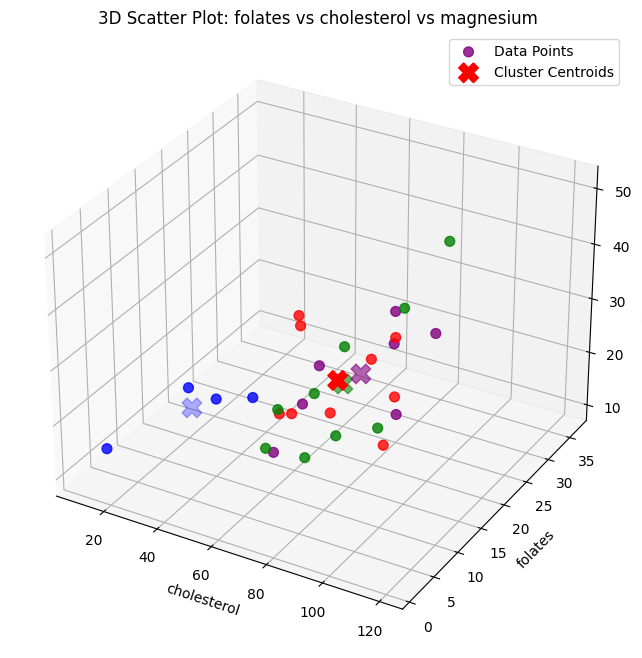

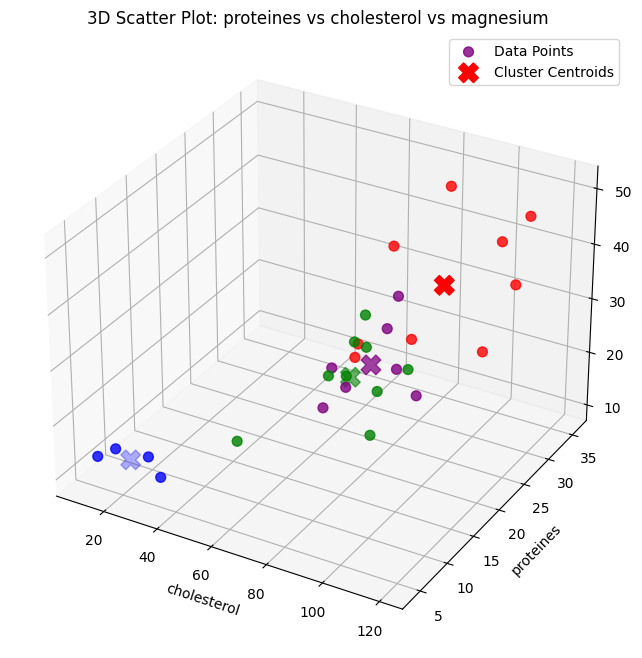

In [ ]:
colors = {0: 'red', 1: 'blue', 2: 'green', 3: 'purple'}

# Create 3D scatter plots for each triplet of features
feature_names = fromage.columns

for i in range(len(feature_names)):
    for j in range(i + 1, len(feature_names)):
        for k in range(j + 1, len(feature_names)):
            fig = plt.figure(figsize=(8, 8))
            ax = fig.add_subplot(111, projection='3d')

            # Scatter plot for data points
            ax.scatter(
                fromage.iloc[:, j],
                fromage.iloc[:, i],
                fromage.iloc[:, k],
                c=[colors[label] for label in kmeans.labels_],
                s=50,
                alpha=0.8,
                label='Data Points',
            )

            # Scatter plot for cluster centroids
            ax.scatter(
                kmeans.cluster_centers_[:, j],
                kmeans.cluster_centers_[:, i],
                kmeans.cluster_centers_[:, k],
                c=[colors[i] for i,cluster in enumerate(centroids_attributes.index)],  # You can choose a different color for centroids
                marker='X',  # You can choose a different marker style
                s=200,  # Marker size
                label='Cluster Centroids',
            )

            ax.set_xlabel(feature_names[j])
            ax.set_ylabel(feature_names[i])
            ax.set_zlabel(feature_names[k])
            ax.set_title(f'3D Scatter Plot: {feature_names[i]} vs {feature_names[j]} vs {feature_names[k]}')

            ax.legend()
            plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

[0.5068135469058542, 0.37299770707104013, 0.3369907041718868, 0.35737615948947093, 0.31349990068046313, 0.28416085394776636, 0.2775340734626103, 0.27082924162843336, 0.26530588371276986]


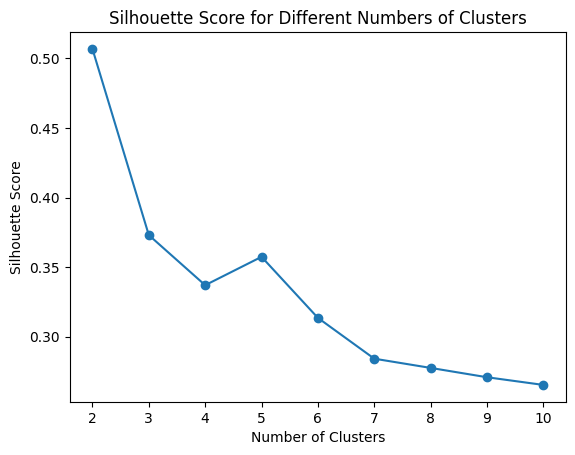

In [ ]:
silhouette_scores = []

for n_clusters in range(9):
    # Fit KMeans model
    kmeans = cluster.KMeans(n_clusters=n_clusters+2, random_state=42)
    kmeans.fit(fromage)

    # Compute silhouette score
    silhouette_avg = silhouette_score(fromage, kmeans.labels_)
    silhouette_scores.append(silhouette_avg)
print(silhouette_scores)
# Plot the silhouette scores
plt.plot(range(2,11), silhouette_scores, marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score for Different Numbers of Clusters')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

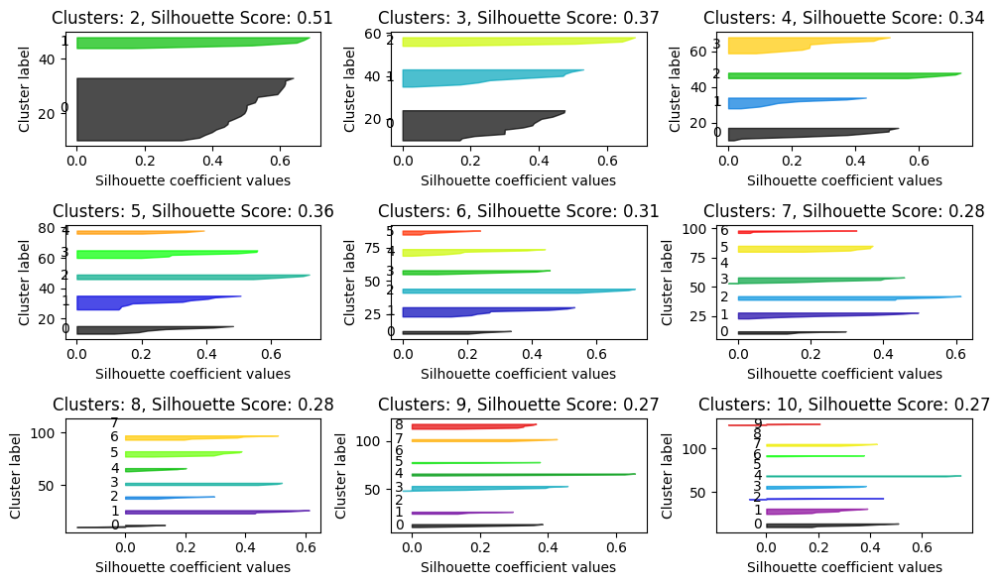

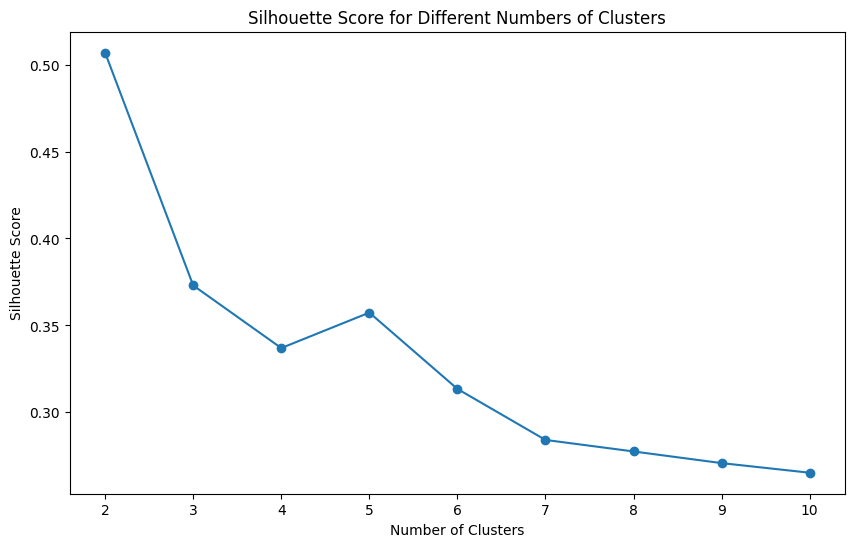

In [ ]:
range_n_clusters = range(2, 11)

# Store silhouette scores for each cluster number
silhouette_scores = []

# Plot silhouette scores for different numbers of clusters
plt.figure(figsize=(10, 6))

for n_clusters in range_n_clusters:
    # Create subplot for each number of clusters
    plt.subplot(3, 3, n_clusters - 1)

    # Fit KMeans model
    kmeans = cluster.KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(fromage)

    # Compute silhouette score
    silhouette_avg = silhouette_score(fromage, cluster_labels)
    silhouette_scores.append(silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(fromage, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = plt.cm.nipy_spectral(float(i) / n_clusters)
        plt.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        plt.text(
            -0.05,
            y_lower + 0.5 * size_cluster_i,
            str(i),
            color="black",
            fontsize=10,
            verticalalignment="center",
        )

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    plt.title(f'Clusters: {n_clusters}, Silhouette Score: {silhouette_avg:.2f}')
    plt.xlabel("Silhouette coefficient values")
    plt.ylabel("Cluster label")

# Display average silhouette score plot
plt.tight_layout()
plt.show()

# Plot the silhouette scores for different numbers of clusters
plt.figure(figsize=(10, 6))
plt.plot(range_n_clusters, silhouette_scores, marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score for Different Numbers of Clusters')
plt.show()

 The silhouette plot shows that the n_clusters value of 7, 8 ,9 and 10 are a bad pick for the given data due to the presence of clusters with below average silhouette scores.


 It also shows that the n_clusters of 2 result in dispropotion with the cluster sizes, for example when the n_clusters=2 , the silhouette plot for cluster 0 is bigger remarkably in size than cluster 1.

 In my point of view the values of n_clusters that we retain are : 4 or 5 or 3

# **Partie 3 : Classification ascendante hiérarchique**

In [ ]:
Z = linkage(fromage,method='ward', metric='euclidean')
Z
#the first column and the second column represent that are merged at each step(first step , we merged the data point 16 with 20 , the second 17 and 18
# and since we have 29 data points so the newest cluster will be 30 etc)
# the third column represents the distance between two clusters being merged using the ward linkage method and the euclidian distance
#the 4th columns represents the number of data points in the cluster

array([[ 16.        ,  20.        ,  33.64119498,   2.        ],
       [ 17.        ,  18.        ,  37.47452468,   2.        ],
       [  1.        ,  23.        ,  38.02841043,   2.        ],
       [  2.        ,   9.        ,  45.00877692,   2.        ],
       [ 21.        ,  26.        ,  49.66356814,   2.        ],
       [  3.        ,  30.        ,  58.4642911 ,   3.        ],
       [ 11.        ,  27.        ,  59.83895053,   2.        ],
       [  6.        ,  10.        ,  61.06209954,   2.        ],
       [ 22.        ,  31.        ,  70.17045912,   3.        ],
       [ 25.        ,  35.        ,  80.84746955,   3.        ],
       [  5.        ,  19.        ,  87.48159806,   2.        ],
       [ 15.        ,  28.        ,  88.28833445,   2.        ],
       [  7.        ,  33.        ,  90.54197921,   3.        ],
       [ 14.        ,  24.        ,  94.70348462,   2.        ],
       [ 12.        ,  32.        ,  96.77015725,   3.        ],
       [ 37.        ,  41

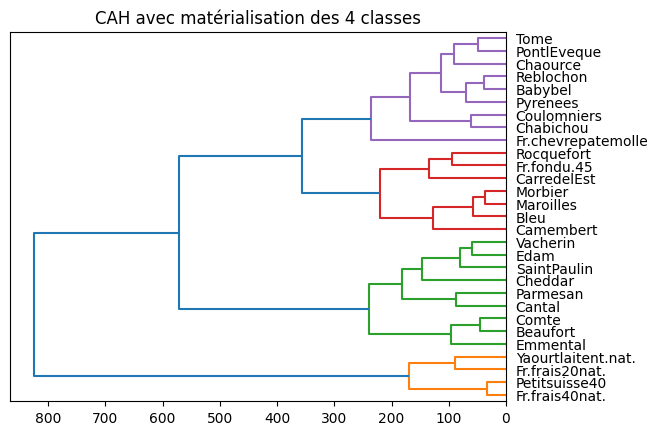

In [ ]:
plt.title("CAH")
plt.title('CAH avec matérialisation des 4 classes')
dendrogram(Z,labels=fromage.index,orientation='left',color_threshold=255)
plt.show()

In [ ]:
#this method is used to form the clusters
#Z : is the linkage matrix
#t : is the threshold that if the linkage distance is less or equal to 255 , we will have a new cluster
#criterion=distance : this means that the t will be considered as a distance
groupes_cah = fcluster(Z, t = 255,criterion='distance')
print(groupes_cah)
print(len(groupes_cah))

[3 4 2 3 3 2 4 4 2 2 4 2 2 4 3 1 1 3 3 2 1 4 4 4 3 2 4 2 1]
29


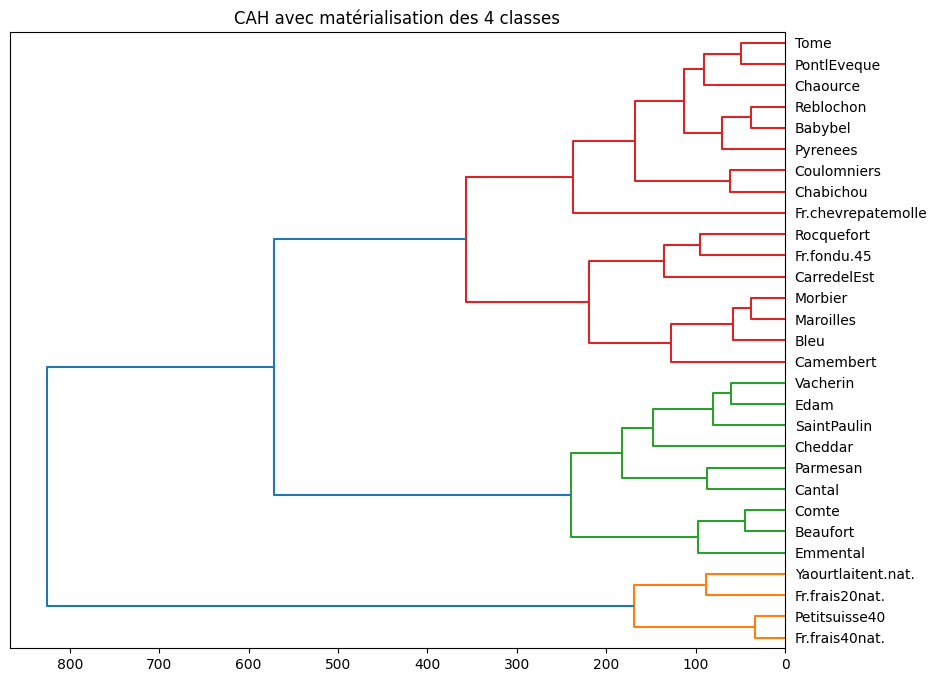

In [ ]:
plt.figure(figsize=(10, 8))

plt.title("CAH")
plt.title('CAH avec matérialisation des 4 classes')
dendrogram(Z,labels=fromage.index,orientation='left',color_threshold=400)
plt.show()

In [ ]:
groupes_cah = fcluster(Z, t = 255,criterion='distance')
print(groupes_cah)
print(len(groupes_cah))

[3 4 2 3 3 2 4 4 2 2 4 2 2 4 3 1 1 3 3 2 1 4 4 4 3 2 4 2 1]
29


after doing the fcluster method , it shows that our data were partitioned in 4 clusters using the ward method with a threshold <= 255

we can try another value of threshold , for example 400 we have obtained only 3 clusters

In [ ]:
#index triés des groupes
idg = np.argsort(groupes_cah)
#affichage des observations et leurs groupe
result=pd.DataFrame(fromage.index[idg],groupes_cah[idg])
result

,Fromages
1,Yaourtlaitent.nat.
1,Petitsuisse40
1,Fr.frais40nat.
1,Fr.frais20nat.
2,SaintPaulin
2,Beaufort
2,Cantal
2,Parmesan
2,Cheddar
2,Comte


In [ ]:
# For Groupe_CAH = 1, there are 4 data points assigned to KMeans cluster 2.
# For Groupe_CAH = 2, there are 9 data points assigned to KMeans cluster 1.
# For Groupe_CAH = 3, there are 7 data points assigned to KMeans cluster 4.
# For Groupe_CAH = 4, there are 9 data points assigned to KMeans cluster 3.
pd.crosstab(groupes_cah, kmeans.labels_+1,rownames=['Groupe_CAH'], colnames=['Cluster_KMeans'])

Cluster_KMeans,1,2,3,4
Groupe_CAH,,,,
1,0,0,4,0
2,0,8,0,1
3,1,0,0,6
4,6,0,0,3


# **Partie 3 : Interprétation des classes**

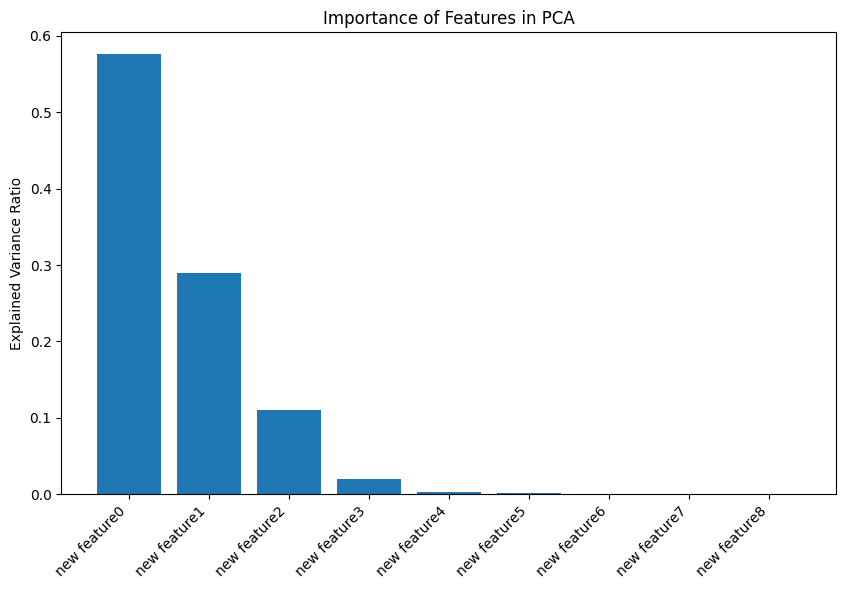

In [ ]:
acp = PCA(n_components=9)
acp.fit(fromage)
explained_variance_ratio = acp.explained_variance_ratio_

feature_names = ['feature'+str(i) for i in range(9)]

sorted_features = ["new "+feature for _, feature in sorted(zip(explained_variance_ratio, feature_names), reverse=True)]

# Plot the importance of features in the first two principal components
fig, ax = plt.subplots(figsize=(10, 6))
ax.bar(range(len(sorted_features)), explained_variance_ratio, align='center')
ax.set_xticks(range(len(sorted_features)))
ax.set_xticklabels(sorted_features, rotation=45, ha='right')
ax.set_ylabel('Explained Variance Ratio')
ax.set_title('Importance of Features in PCA')

plt.show()

this shows that "calories" and "Sodium" explain about 85% of the total variance
so we can retain only the two first components

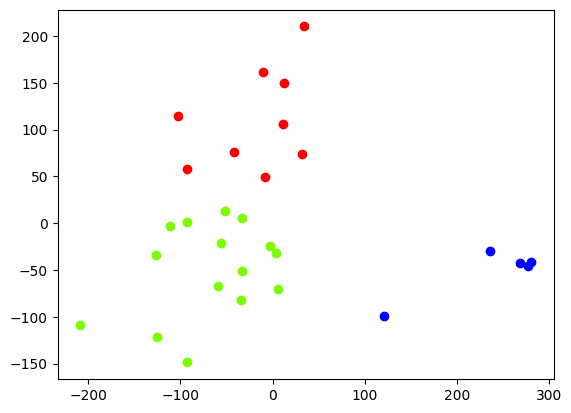

In [ ]:
acp = PCA(n_components =2).fit_transform(fromage)
for couleur,k in zip(['red','blue','lawngreen', 'aqua'],[0,1,2,3]):
  plt.scatter(acp[kmeans.labels_==k,0],acp[kmeans.labels_==k,1],c=couleur)
plt.show()

this scatter plot shows us a clear partitions of the data points , this indicates that the principal components extracted by PCA are effective in capturing the variability in the data.

In our case , two components were sufficient to extract and understand 85% of the data

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


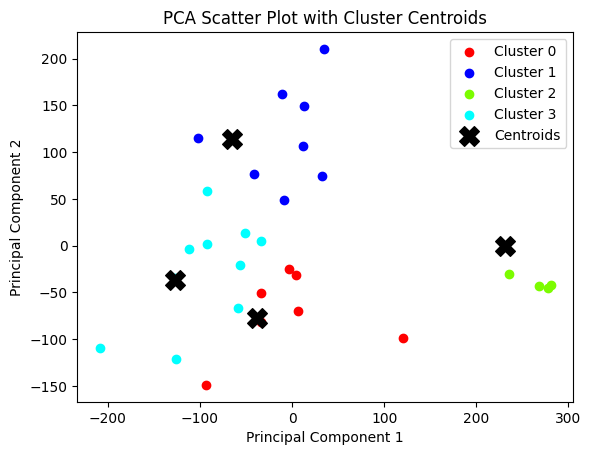

In [ ]:
acp = PCA(n_components=2).fit_transform(fromage)

kmeans.fit(fromage)

for couleur, k in zip(['red', 'blue', 'lawngreen', 'aqua'], [0, 1, 2, 3]):
    plt.scatter(acp[kmeans.labels_ == k, 0], acp[kmeans.labels_ == k, 1], c=couleur, label=f'Cluster {k}')

centroids_acp = PCA(n_components=2).fit_transform(kmeans.cluster_centers_)

plt.scatter(centroids_acp[:, 0], centroids_acp[:, 1], marker='X', s=200, c='black', label='Centroids')

plt.legend()
plt.title('PCA Scatter Plot with Cluster Centroids')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.show()


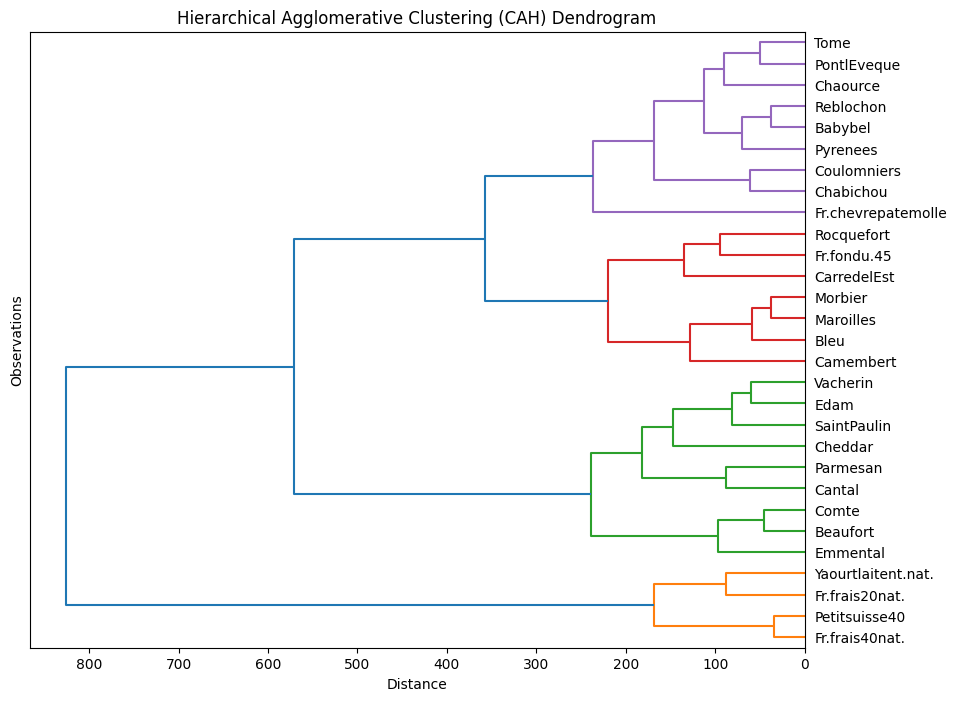

Cluster Labels: [1 2 0 1 1 0 2 2 0 0 2 0 0 2 1 3 3 1 1 0 3 2 2 2 1 0 2 0 3]
Grouped Data:
             Fromages
0         SaintPaulin
0            Beaufort
0            Parmesan
0              Cantal
0             Cheddar
0               Comte
0            Vacherin
0                Edam
0            Emmental
1         CarredelEst
1          Rocquefort
1             Morbier
1           Maroilles
1         Fr.fondu.45
1           Camembert
1                Bleu
2         Coulomniers
2            Chaource
2           Chabichou
2         PontlEveque
2            Pyrenees
2           Reblochon
2             Babybel
2                Tome
2  Fr.chevrepatemolle
3      Fr.frais20nat.
3      Fr.frais40nat.
3       Petitsuisse40
3  Yaourtlaitent.nat.


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


In [ ]:
Z = linkage(fromage, method='ward', metric='euclidean')

# Plot the dendrogram
plt.figure(figsize=(10, 8))
plt.title("Hierarchical Agglomerative Clustering (CAH) Dendrogram")
dendrogram(Z, labels=fromage.index, orientation='left', color_threshold=255)
plt.xlabel('Distance')
plt.ylabel('Observations')
plt.show()

# Apply Agglomerative Clustering
n_clusters = 4  # You can choose the number of clusters
cah = AgglomerativeClustering(n_clusters=n_clusters, affinity='euclidean', linkage='ward')
cah_labels = cah.fit_predict(fromage)

# Display cluster labels
print("Cluster Labels:", cah_labels)

# Display sorted observations and their clusters
idg = np.argsort(cah_labels)
grouped_data = pd.DataFrame(fromage.index[idg], cah_labels[idg])
print("Grouped Data:")
print(grouped_data)

In [ ]:
pd.crosstab(cah_labels, kmeans.labels_,rownames=['Groupe_CAH'], colnames=['Cluster_KMeans'])

Cluster_KMeans,0,1,2,3
Groupe_CAH,,,,
0,0,8,0,1
1,1,0,0,6
2,6,0,0,3
3,0,0,4,0


In [ ]:
from scipy.spatial.distance import pdist, squareform
import numpy as np

# Compute pairwise Euclidean distances
distance_matrix = squareform(pdist(fromage, 'euclidean'))
print(distance_matrix)
# Convert to DataFrame
distance_df = pd.DataFrame(distance_matrix, index=fromage.index, columns=fromage.index)

print("Distance Matrix:")
distance_df

[[  0.         181.47922746 323.51901026 144.73075002 165.60890677
  223.76876458 170.51237492 119.85937594 237.54574296 319.22813159
  133.229839   289.38816493 385.81249332 243.85003588 110.98049378
  402.88301031 387.8980794  175.65921553 167.53345934 298.51859239
  377.79919269 158.13010466 169.48466007 157.00003185 139.82674994
  241.8418905  118.09572389 260.20432356 392.22612101]
 [181.47922746   0.         169.67286171 109.37394571 104.58824026
   81.95114398 140.84097415 106.42950719 124.12538016 178.64822977
  133.66046536 112.07649174 217.99552748 212.96293105 159.89383978
  320.15144854 317.6309966   86.69077229  59.57826785 146.28581613
  311.34222328  58.23229345  56.8617622   38.02841043 210.83858755
   63.10427878  86.64854298 100.44610495 293.01167212]
 [323.51901026 169.67286171   0.         241.15293902 263.17214898
  151.73934888 208.51249363 249.87404827 101.56451152  45.00877692
  237.00894498  93.58172899  75.87417215 301.92755754 317.92464516
  368.06791493 356.

Fromages,CarredelEst,Babybel,Beaufort,Bleu,Camembert,Cantal,Chabichou,Chaource,Cheddar,Comte,...,Parmesan,Petitsuisse40,PontlEveque,Pyrenees,Reblochon,Rocquefort,SaintPaulin,Tome,Vacherin,Yaourtlaitent.nat.
Fromages,,,,,,,,,,,,,,,,,,,,,
CarredelEst,0.000000,181.479227,323.519010,144.730750,165.608907,223.768765,170.512375,119.859376,237.545743,319.228132,...,298.518592,377.799193,158.130105,169.484660,157.000032,139.826750,241.841890,118.095724,260.204324,392.226121
Babybel,181.479227,0.000000,169.672862,109.373946,104.588240,81.951144,140.840974,106.429507,124.125380,178.648230,...,146.285816,311.342223,58.232293,56.861762,38.028410,210.838588,63.104279,86.648543,100.446105,293.011672
Beaufort,323.519010,169.672862,0.000000,241.152939,263.172149,151.739349,208.512494,249.874048,101.564512,45.008777,...,159.463162,346.751467,189.921036,155.694894,198.865683,338.430126,148.852108,214.730086,103.704870,354.452874
Bleu,144.730750,109.373946,241.152939,0.000000,109.821036,102.236931,197.889211,137.661687,185.268157,255.895467,...,173.170898,403.296913,136.943346,112.549278,84.038920,121.971103,151.672377,126.756499,199.332336,376.399283
Camembert,165.608907,104.588240,263.172149,109.821036,0.000000,145.785425,196.865131,97.483024,214.234754,275.211973,...,188.913790,350.588448,129.444583,144.570606,78.794416,175.393985,133.859292,135.266736,195.250659,308.181765
Cantal,223.768765,81.951144,151.739349,102.236931,145.785425,0.000000,196.657952,170.187573,128.222385,176.845752,...,87.481598,382.302773,132.697362,89.423207,90.286599,206.881850,89.179033,147.310692,133.497453,353.549021
Chabichou,170.512375,140.840974,208.512494,197.889211,196.865131,196.657952,0.000000,113.069713,124.455092,187.424305,...,257.312223,274.654255,102.302297,112.780849,148.338060,254.904158,185.702154,86.812384,152.048611,333.081161
Chaource,119.859376,106.429507,249.874048,137.661687,97.483024,170.187573,113.069713,0.000000,174.186021,246.915795,...,228.490612,309.812944,91.077659,115.418456,87.868424,183.445660,159.134880,72.352401,179.065742,317.308903
Cheddar,237.545743,124.125380,101.564512,185.268157,214.234754,128.222385,124.455092,174.186021,0.000000,94.766555,...,173.125475,335.603978,129.551341,85.313481,144.347601,263.804928,144.574756,134.389062,106.063990,364.184335


In [ ]:
np.sum(distance_matrix,axis=1)/len(fromage)

array([224.0211885 , 144.2258601 , 210.99228874, 184.96493471,
       183.69580453, 172.04103389, 183.80208938, 171.16217116,
       180.93978453, 213.57659803, 179.48738381, 178.65373284,
       249.36618941, 232.01825878, 217.62254031, 312.30855773,
       304.98011096, 174.21411306, 158.46465778, 216.68611638,
       299.95938598, 148.48607997, 150.10233999, 149.1876422 ,
       258.97102855, 161.60922277, 158.08822338, 166.6313587 ,
       301.28226178])

In [ ]:
np.linalg.norm(distance_matrix[0,:])/len(fromage)

45.68683270397291

In [ ]:
distance_df[['Cheddar', 'Edam']]

Fromages,Cheddar,Edam
Fromages,,
CarredelEst,237.545743,289.388165
Babybel,124.125380,112.076492
Beaufort,101.564512,93.581729
Bleu,185.268157,202.561250
Camembert,214.234754,195.052608
Cantal,128.222385,118.036393
Chabichou,124.455092,195.180122
Chaource,174.186021,202.044748
Cheddar,0.000000,127.406397


**Divisive clustering based **



In [ ]:
def calculate_average_distance(fromage, cluster, i):
    distance_matrix = squareform(pdist(fromage.iloc[cluster], 'euclidean'))
    if len(cluster) > 1:
        return np.linalg.norm(distance_matrix[i, :]) / (len(cluster) - 1)
    else:
        return 0.0

In [ ]:
def compute_dx(fromage, Ci, Cj):
    dx_values = []
    for i, x in enumerate(Ci):
        avg_distance_x_Ci = calculate_average_distance(fromage, Ci, i)

        avg_distance_x_Cj = calculate_average_distance(fromage, [x] + Cj, 0)

        dx = avg_distance_x_Ci - avg_distance_x_Cj
        dx_values.append(dx)
    return dx_values

In [ ]:
def split_cluster(fromage, cluster):
    Ci = cluster
    Cj = []

    while True:
        dx_values = compute_dx(fromage, Ci, Cj)
        if not dx_values:
            break

        max_dx_index = np.argmax(dx_values)
        max_dx_value = dx_values[max_dx_index]

        if max_dx_value <= 0:
            break

        x_to_move = Ci[max_dx_index]
        Ci.remove(x_to_move)
        Cj.append(x_to_move)

    return Ci, Cj


In [ ]:
def calculate_diameter(fromage, cluster):
    distance_matrix = squareform(pdist(fromage.iloc[cluster], 'euclidean'))
    return np.max(distance_matrix)

def find_cluster_with_max_diameter(clusters, fromage):
    max_diameter = float('-inf')
    cluster_to_split = None

    for cluster in clusters:
        diameter = calculate_diameter(fromage, cluster)
        if diameter > max_diameter:
            max_diameter = diameter
            cluster_to_split = cluster

    return cluster_to_split

**Splitting using the maximum distance**

In [ ]:
def divisive_hierarchical_clustering(fromage):
    clusters = [list(range(len(fromage)))]

    while any(len(cluster) > 1 for cluster in clusters):
        print("cluster :",clusters)
        cluster_to_split = find_cluster_with_max_diameter(clusters,fromage)
        print(cluster_to_split)
        Ci, Cj = split_cluster(fromage, cluster_to_split)
        clusters.remove(cluster_to_split)

        if Ci:
            clusters.append(Ci)
        if Cj:
            clusters.append(Cj)
    return clusters


**Splitting using kmeans clustering**

In [ ]:
from sklearn.cluster import KMeans

def divisive_kmeans_clustering(data, k):
    clusters = [list(range(len(data)))]

    while any(len(group) > 1 for group in clusters):
        cluster_to_split = find_cluster_with_max_diameter(clusters, data)

        kmeans = KMeans(n_clusters=k)
        cluster_assignments = kmeans.fit_predict(data.iloc[cluster_to_split])
        print(cluster_assignments)
        sub_clusters = [np.array(cluster_to_split)[cluster_assignments == i].tolist() for i in range(k)]
        print(sub_clusters)
        clusters.remove(cluster_to_split)
        clusters.extend(sub_clusters)

    return clusters

In [ ]:
resulting_clusters = divisive_kmeans_clustering(fromage, 2)
# Print the resulting clusters
for i, cluster in enumerate(resulting_clusters):
    print(f"Cluster {i + 1}: {cluster}")

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

[0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 1 0 0 0 1 0 0 0 0 0 0 0 1]
[[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 19, 21, 22, 23, 24, 25, 26, 27], [13, 15, 16, 20, 28]]
[0 0 1 0 0 1 0 0 1 1 0 1 1 0 0 0 1 0 0 0 0 1 0 1]
[[0, 1, 3, 4, 6, 7, 10, 14, 17, 18, 21, 22, 23, 24, 26], [2, 5, 8, 9, 11, 12, 19, 25, 27]]
[1 0 1 1 0 0 0 1 1 1 0 0 0 1 0]
[[1, 6, 7, 10, 21, 22, 23, 26], [0, 3, 4, 14, 17, 18, 24]]
[1 0 0 0 0]
[[15, 16, 20, 28], [13]]
[0 1 0 0 0 0 1 1 0]
[[2, 8, 9, 11, 12, 27], [5, 19, 25]]
[1 0 0 1 0 0 1]
[[3, 4, 17, 18], [0, 14, 24]]
[1 0 1 0 1 0]
[[8, 11, 27], [2, 9, 12]]
[0 1 1 0]
[[15, 28], [16, 20]]
[0 1 1 1 0 0 0 1]
[[1, 21, 22, 23], [6, 7, 10, 26]]
[1 0 0]
[[14, 24], [0]]
[1 0 0]
[[11, 27], [8]]
[0 0 1]
[[5, 19], [25]]
[0 1 0 1]
[[6, 10], [7, 26]]
[0 1 0 0]
[[3, 17, 18], [4]]
[1 1 0]
[[12], [2, 9]]
[0 1]
[[14], [24]]
[1 0]
[[28], [15]]
[1 0]
[[19], [5]]
[0 1]
[[7], [26]]
[0 1 1 0]
[[1, 23], [21, 22]]
[1 0]
[[22], [21]]
[0 1]
[[6], [10]]
[0 1 1]
[[3], [17, 18]]
[1 0]
[[27], [11

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

In [ ]:
resulting_clusters = divisive_hierarchical_clustering(fromage)
print(len(resulting_clusters))
# Print the resulting clusters
for i, cluster in enumerate(resulting_clusters):
    print(f"Cluster {i + 1}: {cluster}")


cluster : [[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28]]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28]
cluster : [[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28], [15]]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28]
cluster : [[15], [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 17, 18, 19, 21, 22, 23, 24, 25, 26, 27, 28], [16, 20]]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 17, 18, 19, 21, 22, 23, 24, 25, 26, 27, 28]
cluster : [[15], [16, 20], [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 17, 18, 19, 21, 22, 23, 24, 25, 26, 27], [28]]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 17, 18, 19, 21, 22, 23, 24, 25, 26, 27]
cluster : [[15], [16, 20], [28], [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 17, 18, 19, 21, 22, 23, 24, 25, 26, 

In [ ]:
fromage.iloc[[1,2]]

,calories,sodium,calcium,lipides,retinol,folates,proteines,cholesterol,magnesium
Fromages,,,,,,,,,
Babybel,314,238.0,209.8,25.1,63.7,6.4,22.6,70,27
Beaufort,401,112.0,259.4,33.3,54.9,1.2,26.6,120,41
